# This assignment is based on the Zoom In article [https://distill.pub/2020/circuits/zoom-in/] from the Circuits thread by Distill publication.



---



# First Layer Visualization

Let us start by getting an intution about what the early layers are 'seeing' from the input image.

Load the GoogLeNet (InceptionV1) model that has been pretrained on the ImageNet dataset. The pretrained=True flag downloads the model weights that were learned from training on ImageNet. This gives us a powerful model capable of recognizing 1000 different classes of images, and serves as a good starting point for our own image classification tasks.

**What are Hooks in pytorch?**

Hooks in PyTorch are functions attached to nn.Module instances, allowing modification or interception of inputs, outputs, and gradients during the forward and backward passes. Forward hooks, registered with register_forward_hook, modify outputs or save intermediate results during the forward pass. Backward hooks, registered with register_backward_hook, modify gradients during the backward pass. They're useful for debugging, visualization, and custom training procedures, but should be used carefully due to potential debugging difficulties.

In the following code block, a hook is registered on the first convolutional layer of the model. This hook saves the layer's activations when the model processes the input image. After running the model, the activations are retrieved and visualized.

The visualization is a heatmap, where the intensity of the color represents the strength of the activation. This can help us understand what parts of the image are activating the filters in the convolutional layer.

Predicted class: 207
Predicted class name: golden retriever


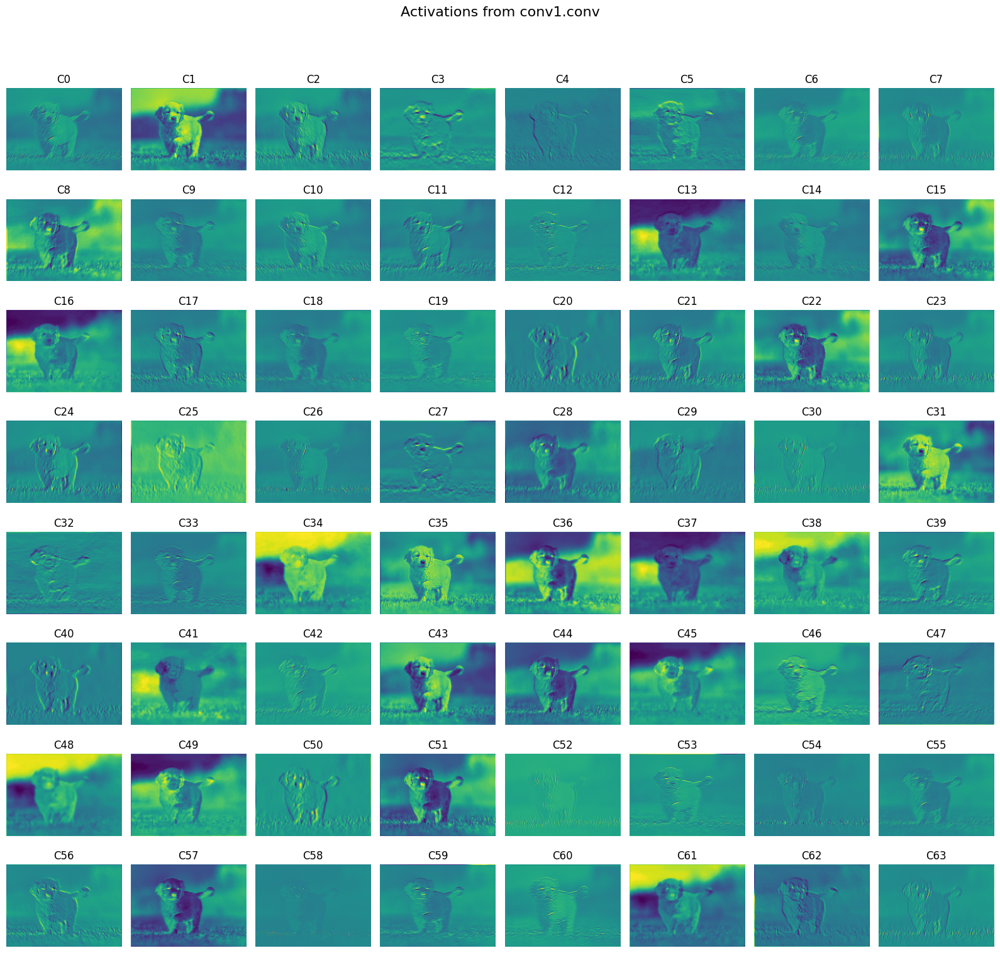

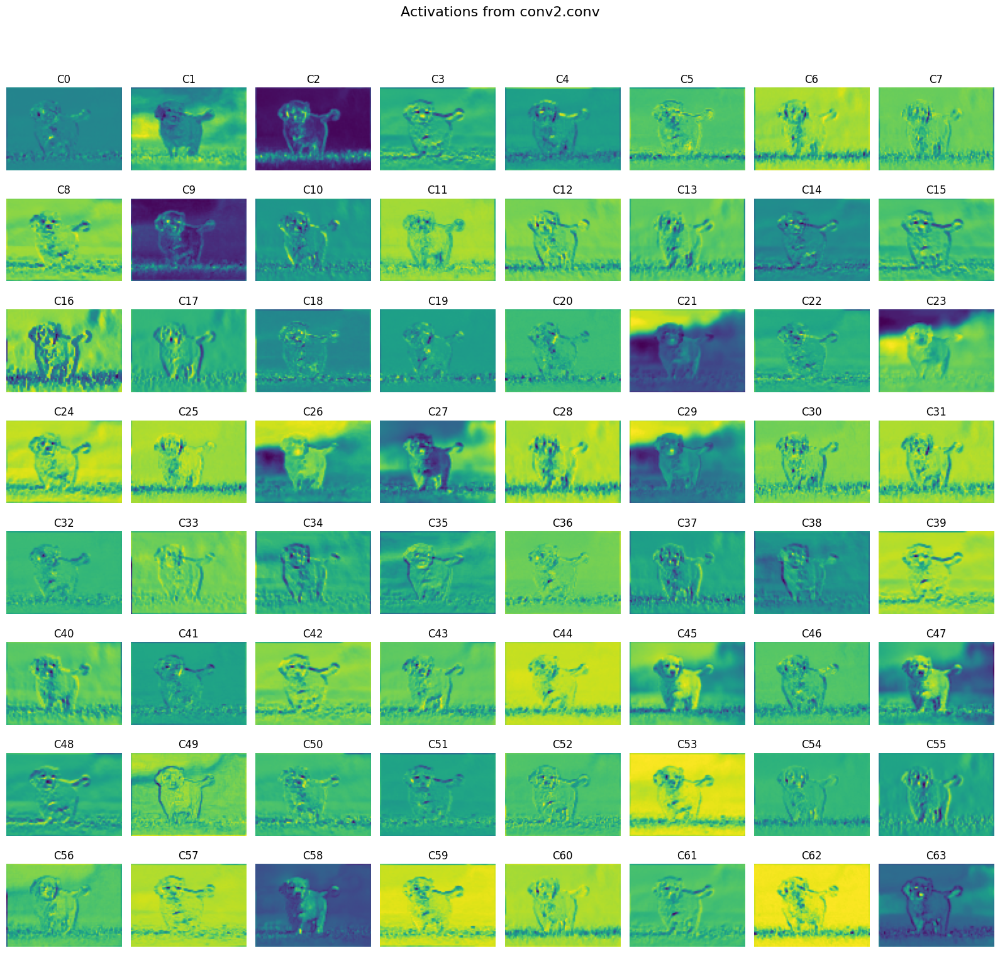

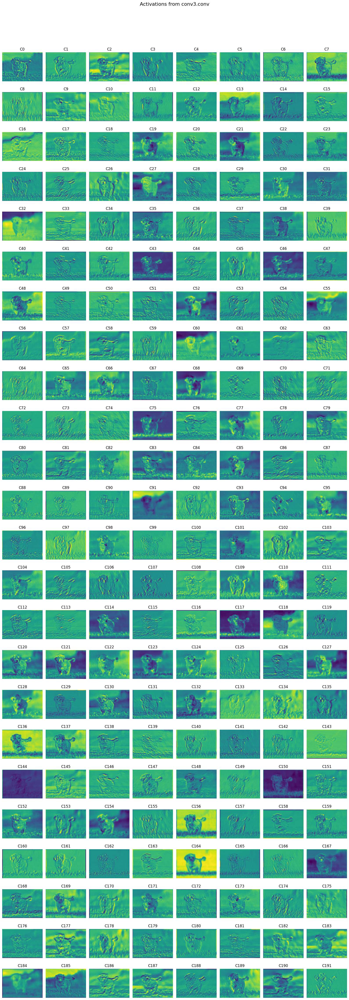

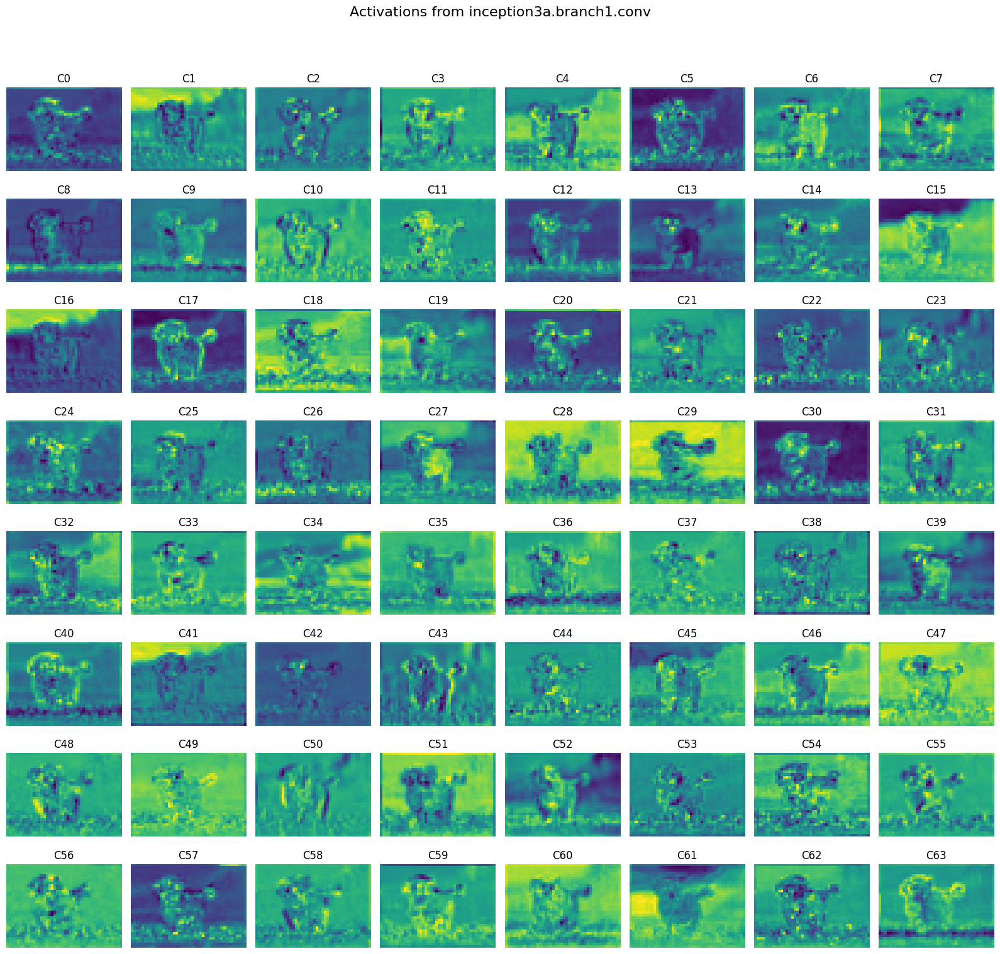

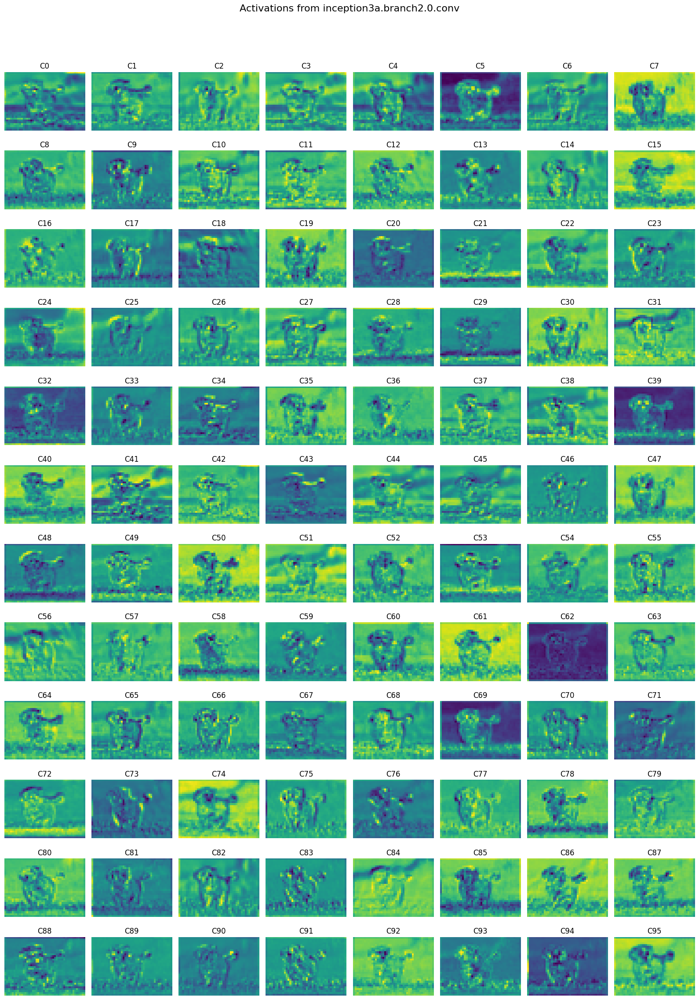

...

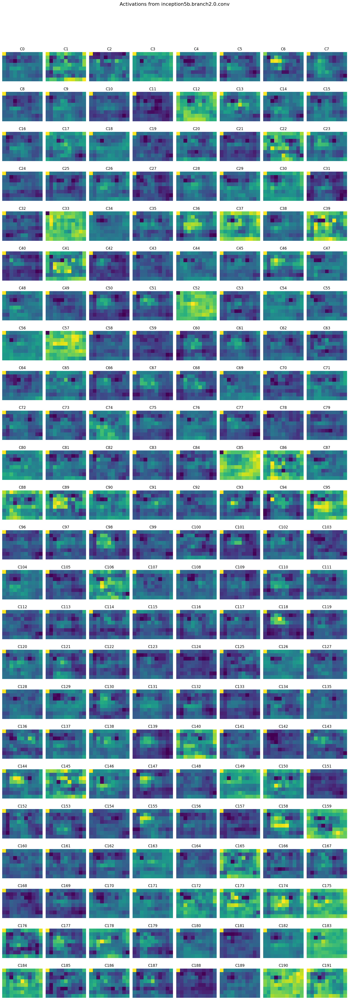

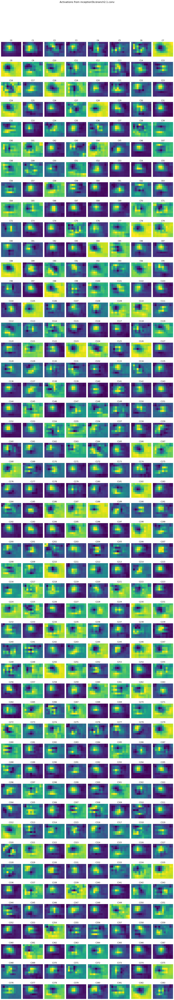

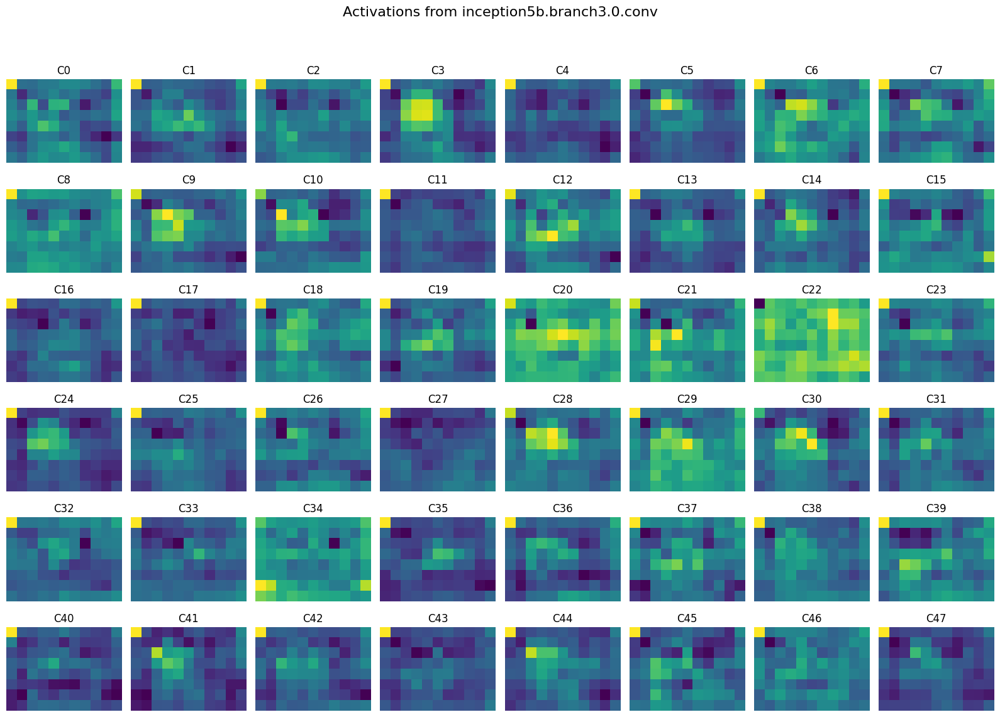

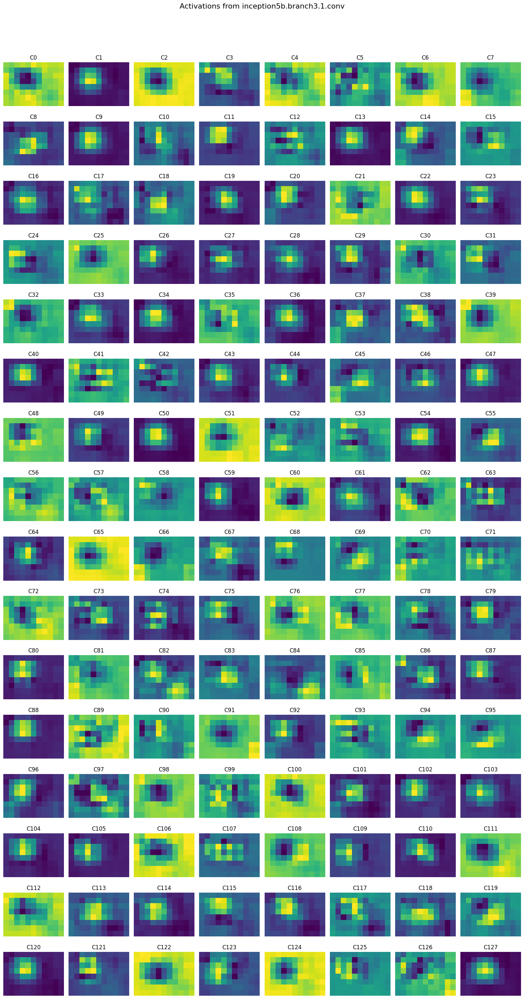

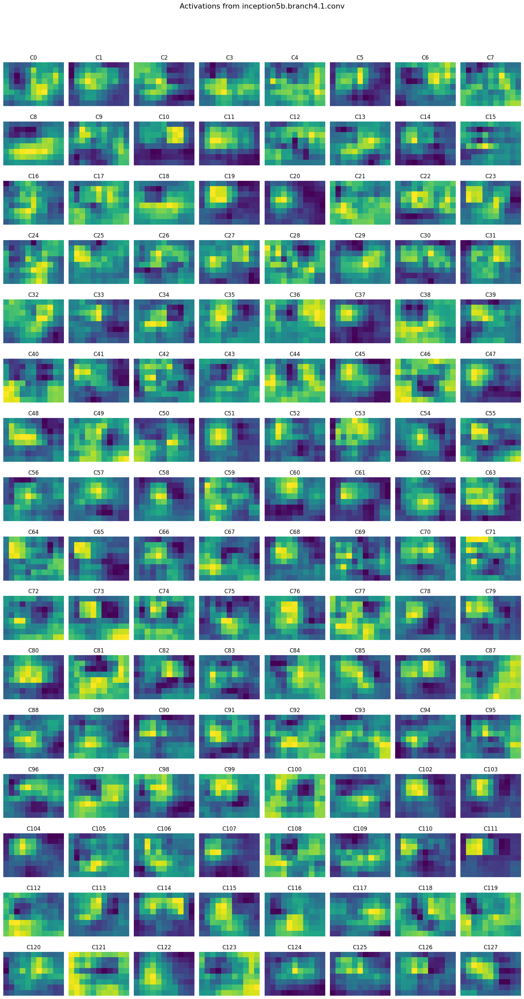

In [ ]:
import torch
import torch.nn as nn
import torchvision.models as models
from torchvision import transforms

import matplotlib.pyplot as plt
from PIL import Image

from torchvision.models import GoogLeNet_Weights
weights = GoogLeNet_Weights.IMAGENET1K_V1
imagenet_labels = weights.meta["categories"]
from io import BytesIO
import requests

# Load an image from a URL
# url = 'https://images.squarespace-cdn.com/content/v1/54e7a1a6e4b08db9da801ded/fdecc7f0-42bf-4696-bd4c-73a868e5d1d2/81.jpg?format=750w'
# url = 'https://images.pexels.com/photos/416160/pexels-photo-416160.jpeg'

headers = {
    'User-Agent': 'Mozilla/5.0 (Windows NT 10.0; Win64; x64) Chrome/137.0.0.0 Safari/537.36'
}
response = requests.get(url, headers=headers)

img = Image.open(BytesIO(response.content))
# Resize the image
img_resized = img.resize((224, 224))  # replace with the desired size

#Load the model
# change this line if you want to use a different model, different models do different things ie image classification, feature extraction, real time inference
# model = models.resnet50(pretrained=True)

model = models.googlenet(pretrained=True)
model.eval()  # Set the model to evaluation mode

# Define the image transformations: resize, crop, convert to tensor, and normalize
transform = transforms.Compose([
    transforms.Resize(256),
   # transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
])
img_t = transform(img)

# Collect activations from all convolutional layers
activations = {}

def get_activation(name):
    def hook(model, input, output):
        activations[name] = output.detach()
    return hook

# Register hooks to all convolutional layers
for name, layer in model.named_modules():
    if isinstance(layer, nn.Conv2d):
        layer.register_forward_hook(get_activation(name))

# Run the model
output = model(img_t.unsqueeze(0))

# Get predicted class
_, predicted = torch.max(output, 1)
class_name = imagenet_labels[predicted.item()]

print('Predicted class:', predicted.item())
print(f'Predicted class name: {class_name}')

# Visualize activations for all layers and channels
for layer_name, layer_activation in activations.items():
    num_channels = layer_activation.shape[1]
    size = layer_activation.shape[2]
    cols = 8
    rows = (num_channels // cols) + 1

    fig = plt.figure(figsize=(cols * 2, rows * 2))
    fig.suptitle(f'Activations from {layer_name}', fontsize=16)

    for channel in range(num_channels):
        ax = fig.add_subplot(rows, cols, channel + 1)
        ax.imshow(layer_activation[0, channel, :, :].cpu(), cmap='viridis')
        ax.axis('off')
        ax.set_title(f'C{channel}')

    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

"""
layer performs a certain transformation
many channels make up a layer, a channel is an individual feature map within that layer

layer checks for different types of details ie color shape
each channel identifies a different feature or characteristic of detail that the layer is trying to determine

later layers use operations like pooling or strided convolutions which downsize the image
later layers capture higher level features instead of pixel level

typically
early layers capture basic features such as edges, lines, textures, colors, simple shapes
middle layers capture more complex patterns like corners, curves, simple object parts (eyes, wheels, leaves, etc)
deeper layers capture abstract and semantic features like full objects (faces, animals, vehicles), complex patterns, specific object characteristics

not recommended to use jet, it's less accurate than viridis. jet is popular because it's pretty
jet low to high: blue -> cyan -> green -> yellow -> red
viridis low to high: purple -> blue -> green -> yellow

task 1 is written in an unclear way, you wouldn't be using different datasets bcs this is performing inference on a single image
you don't set hyperparameters bcs we are performing inference on a pre trained model, not training a model this is not a fine tuning exercise
I feel like a lotta the other ppl doing this are gonna get confused lol

--------

conv1:
  edges, basic shapes, outlines
  channels c1 c3 c5 c31 show dog's body edges

conv2:
  edges, textures, basic patterns
  channels c29 c39 c45 show specific features like the dog's face / body posture

conv3:
  more emphasis on posture / body parts
  c164 detects dog's full body shape, other detect things like legs, posture

inception4c.branch4.1 (middle layer):
  more emphasis on general object parts
  ex possibly related to body shape or fur texture

inception4d.branch1, inception4d.branch2.0 (deeper middle layers):
  dog is pixelated
  for features relevant to recognizing it (body position, ears, limbs, stance)

inception5b.branch3.0, inception5b.branch3.1, inception5b.branch4.1 (deep layers)
  extremely pixelated
  is this for humans
  supposedly "captures conceptual, semantic level information such as dog like features, animal shapes, complex feature combinations"
"""



---



# TASK 1

You can play around with different images as input and try to find what channel of what layer seems to be detecting edges/curves/colors/shapes/textures/gradients etc, submit your findings and insights!

Feel free to use any model/dataset/hyperparameters. You can also choose the colormap that seems to bring out the best visualization for your chosen feature for exploration.



---



# Last Layer Visualization

Predicted class: 207
Predicted class name: golden retriever


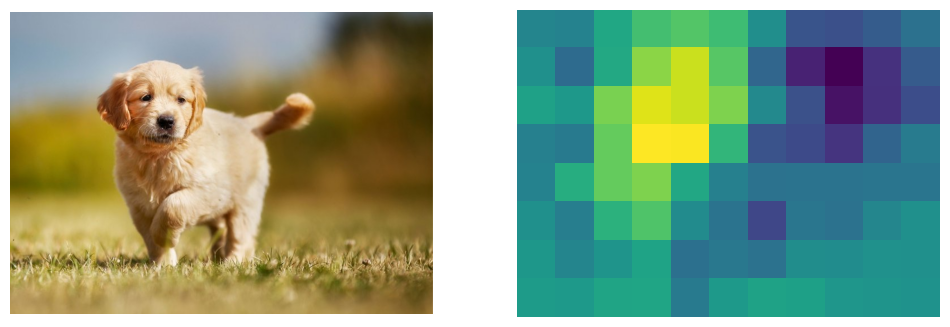

Predicted class: 245
Predicted class name: French bulldog


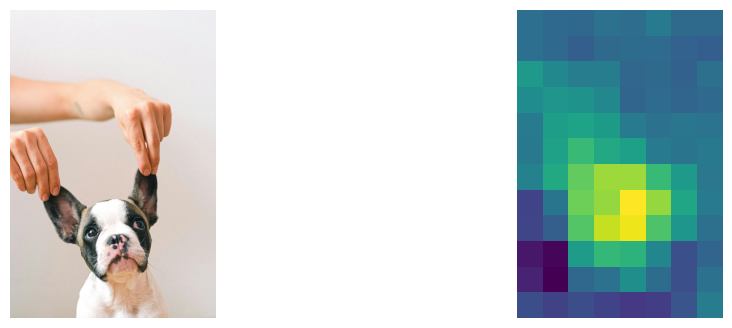

Predicted class: 239
Predicted class name: Bernese mountain dog


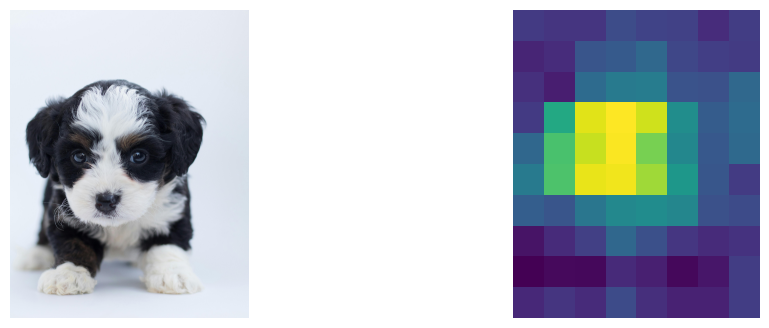

Predicted class: 207
Predicted class name: golden retriever


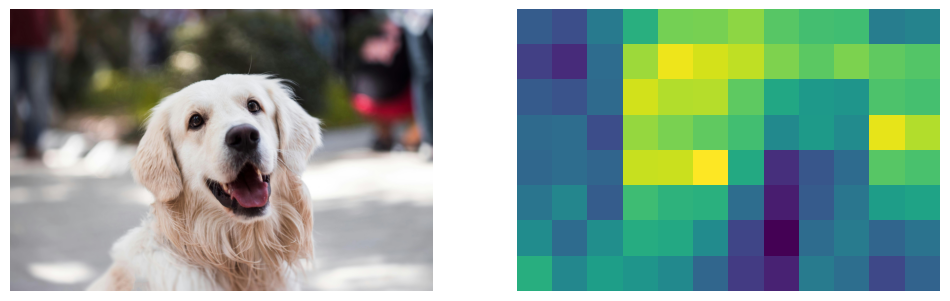

Predicted class: 219
Predicted class name: cocker spaniel


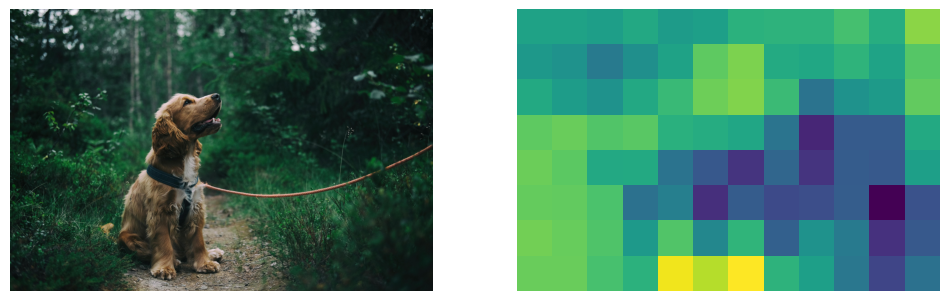

Predicted class: 232
Predicted class name: Border collie


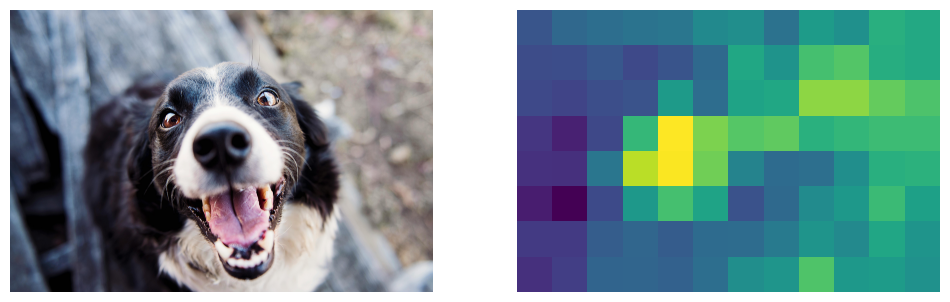

Predicted class: 207
Predicted class name: golden retriever


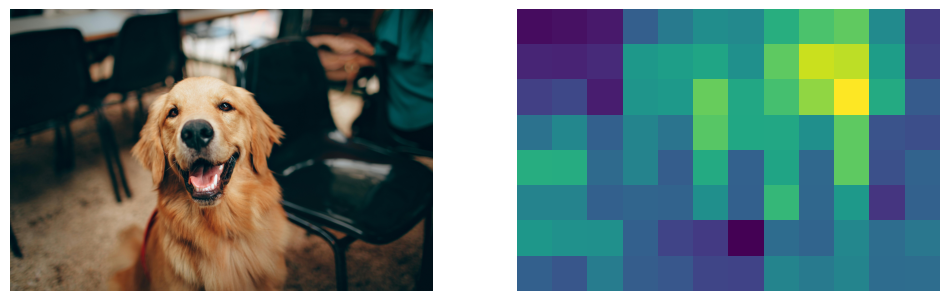

In [ ]:
urls = [
    'https://images.squarespace-cdn.com/content/v1/54e7a1a6e4b08db9da801ded/fdecc7f0-42bf-4696-bd4c-73a868e5d1d2/81.jpg?format=750w',
    'https://images.pexels.com/photos/4587998/pexels-photo-4587998.jpeg',
    'https://images.pexels.com/photos/1458916/pexels-photo-1458916.jpeg',
    'https://images.pexels.com/photos/1490908/pexels-photo-1490908.jpeg',
    'https://images.pexels.com/photos/1254140/pexels-photo-1254140.jpeg',
    'https://images.pexels.com/photos/551628/pexels-photo-551628.jpeg',
    'https://images.pexels.com/photos/2253275/pexels-photo-2253275.jpeg'
]

for url in urls:
    response = requests.get(url)
    img = Image.open(BytesIO(response.content))
    img_resized = img.resize((224, 224))

    model = models.googlenet(pretrained=True)
    model.eval()

    transform = transforms.Compose([
        transforms.Resize(256),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])
    img_t = transform(img)

    last_conv_layer = None
    for name, layer in model.named_modules():
        if 'conv' in name:
            last_conv_layer = layer

    activations = []
    def get_activation(name):
        def hook(model, input, output):
            activations.append(output.detach())
        return hook

    last_conv_layer.register_forward_hook(get_activation('conv_4'))

    output = model(img_t.unsqueeze(0))
    activations = activations[0]

    _, predicted = torch.max(output, 1)
    print('Predicted class:', predicted.item())
    class_name = imagenet_labels[predicted.item()]
    print(f'Predicted class name: {class_name}')

    plt.figure(figsize=(12,4))

    plt.subplot(1,2,1)
    plt.imshow(img)
    plt.axis('off')

    plt.subplot(1,2,2)
    plt.imshow(activations[0, 35, :, :].squeeze(), cmap='viridis')
    plt.axis('off')

    plt.show()

    # sure, possibly a face detector



---



# TASK 2

If you notice, for the above golden retriever image, the 36th channel of last layer seems to detect dog's face. (Since the heatmap shows yellow around dog's face).
Does this mean 36th Channel of last layer is 'face detector'? Can you confirm? Plug different dog pictures as input and check if the activations are constantly focusing on the face area. If not, can you find which channel is somewhat a face detector?
Share your insights.



---



# Activation Maximization

Activation maximization is a technique used to generate images that maximize the activation of specific neurons or filters in a neural network.For example, in the case of curve detectors, the goal is to create an input image that elicits strong activations in the neurons responsible for detecting curves. By iteratively updating the input image to maximize the activation of these neurons, the resulting image tends to exhibit pronounced curves or curve-like patterns.

The following piece of code does this by manually implementing the process of activation maximization, which involves iteratively updating an input image to maximize the activation of the chosen neuron. The final image is then displayed, which should be an image that maximally activates the chosen neuron.

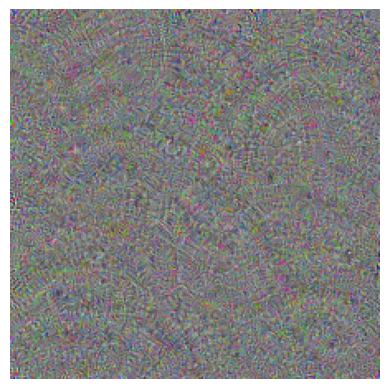

In [ ]:
import numpy as np
from torch.autograd import Variable

# Load model
model = models.googlenet(pretrained=True)
model.eval()

# Choose a neuron
layer_name = 'inception4d.branch1.conv'  # Name of the layer containing the neuron
neuron_index = 25  # Index of the neuron in the layer

# Get the chosen layer
layer = dict(model.named_modules())[layer_name]

# Define a hook to get the activation of the chosen neuron
activation = None
def hook(module, input, output):
    global activation
    activation = output[0, neuron_index].mean()

# Register the hook
handle = layer.register_forward_hook(hook)

# Generate a random input image
input_image = Variable(torch.randn(1, 3, 224, 224), requires_grad=True)

# Define an optimizer
optimizer = torch.optim.Adam([input_image], lr=0.1)

# Perform Activation Maximization
for i in range(100):
    optimizer.zero_grad()
    model(input_image)
    loss = -activation
    loss.backward()
    optimizer.step()

# Remove the hook
handle.remove()

# The resulting input_image should now be an image that maximally activates the chosen neuron

# Convert the tensor to a numpy array
image = input_image.detach().numpy()

# Move the color channel to the last dimension
image = np.transpose(image, (0, 2, 3, 1))

# Normalize the image to the range [0, 1]
image -= image.min()
image /= image.max()

# Plot the image
plt.imshow(image[0], cmap='plasma')
plt.axis('off')
plt.show()



---



# Activation Maximization using Lucent (Lucid for Pytorch) Library

The following piece of code achieves the same goal as above, but does so using the Lucent library, which provides a higher-level interface for visualizing neuron activations. The render_vis function from Lucent automates the process of activation maximization and visualization.

Why does Lucid/Lucent work so much better as showing us 'Interpretable visualizations'?
Lucent uses a technique called feature visualization, which is a way to visualize what a deep learning model has learned. It does this by optimizing an input image to maximize the activations of specific neurons in the model. The optimization process is guided by a loss function that encourages the model to produce high activations for the chosen neurons.

However, simply maximizing the activations can lead to noisy, uninterpretable images. To get more interpretable images, Lucent incorporates several regularization techniques into the optimization process. These techniques encourage the optimized image to have certain desirable properties, such as smoothness, sparsity, or naturalness.

One of the key regularization techniques used by Lucent is called transformation robustness. This technique encourages the optimized image to activate the chosen neurons even when the image is slightly transformed, such as by translating, rotating, or scaling the image. This encourages the model to focus on the high-level features that are invariant to these transformations, rather than on low-level, transformation-sensitive features.

Another technique used by Lucent is called jitter, which adds a small amount of random noise to the image at each step of the optimization process. This helps to prevent the model from overfitting to the specific pixel values of the image, and encourages it to focus on the high-level features.

By combining these and other techniques, Lucent is able to generate beautiful, interpretable images that give us insight into what a deep learning model has learned.

In [ ]:
!pip install torch-lucent

# Activation for LAYER - Conv 1, UNIT - 1

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=GoogLeNet_Weights.IMAGENET1K_V1`. You can also use `weights=GoogLeNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
100%|██████████| 512/512 [00:11<00:00, 46.45it/s]


Layer: conv1, Channel: 1


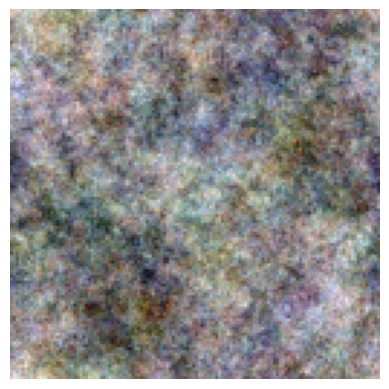

In [ ]:
## Lucent
import lucent
from lucent.optvis import render, param, transform, objectives

# Load the InceptionV1 model
# model = models.googlenet(pretrained=True)
# model.eval()

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = models.googlenet(pretrained=True).to(device).eval()

# Define the layer and channel you want to visualize
layer = 'conv1'
channel = 1

# Define the objective: maximize the activation of the specified channel
objective = objectives.channel(layer, channel)

# Define the parameterization: a 128x128 image with random noise
param_f = lambda: param.image(128)

# Render the visualization
image = render.render_vis(model, objective, param_f)
print(f"Layer: {layer}, Channel: {channel}")

img = image[0][0]
img = (img - img.min()) / (img.max() - img.min())
plt.imshow(img)

plt.axis('off')  # To turn off the axis, making the image cleaner
plt.show()

#Output file: conv1_1.png

"""
lucent requires you to normalize the image array before plotting

specifically, this part is incorrect:
  plt.imshow(image[0][0, :, :, 0:3])

it needs to be changed to this:
  img = image[0][0]
  img = (img - img.min()) / (img.max() - img.min())
  plt.imshow(img)

img = (img - img.min()) / (img.max() - img.min()) normalizes the image data to the [0, 1] range
  image.min() finds the min pix value
  img - img.min() shifts all values so the smallest value becomes 0
  dividing by img.max() - img.min() scales the data to the range [0, 1]
"""



---



#TASK 3

The above output file shows blank image. Can you figure out why this could be happening?



---



#Activation for LAYER - MIXED 4d, UNIT -25

Downloading: "https://github.com/ProGamerGov/pytorch-old-tensorflow-models/raw/master/inception5h.pth" to /root/.cache/torch/hub/checkpoints/inception5h.pth
100%|██████████| 27.0M/27.0M [00:00<00:00, 130MB/s]
100%|██████████| 512/512 [00:25<00:00, 20.02it/s]


Layer: Mixed_4D, Channel: 25


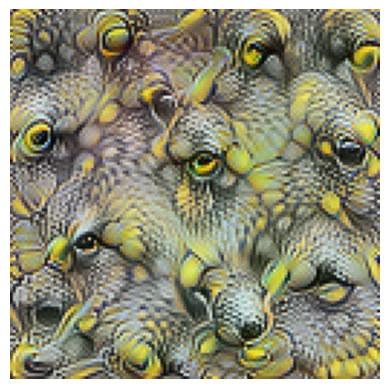

In [ ]:
from lucent.modelzoo import inceptionv1

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
model = inceptionv1(pretrained=True)
model.to(device).eval()
image = render.render_vis(model, "mixed4d:25")
print(f"Layer: {'Mixed_4D'}, Channel: {'25'}")
plt.imshow(image[0][0, :, :, 0:3])
plt.axis('off')  # To turn off the axis, making the image cleaner
plt.show()

#Output file: mixed4d_25.png

"""
This image is a visualization produced by a neural network visualization technique (like those created by Lucent, DeepDream, or similar methods).
Specifically, it appears to be a feature visualization, representing patterns or structures that strongly activate a particular neuron or channel within a convolutional neural network (CNN).
In this visualization:
Patterns and textures: The repeated and complex patterns indicate the particular features that strongly activate the chosen layer/channel.
Complexity and surreal appearance: These types of images typically look somewhat surreal because they're artificially generated to maximize activations, revealing what a neural network has internally "learned."
This visualization doesn't represent a real object or creature. Instead, it shows the abstract concept or combination of features that this specific neural network channel "likes" or responds to most strongly.
"""

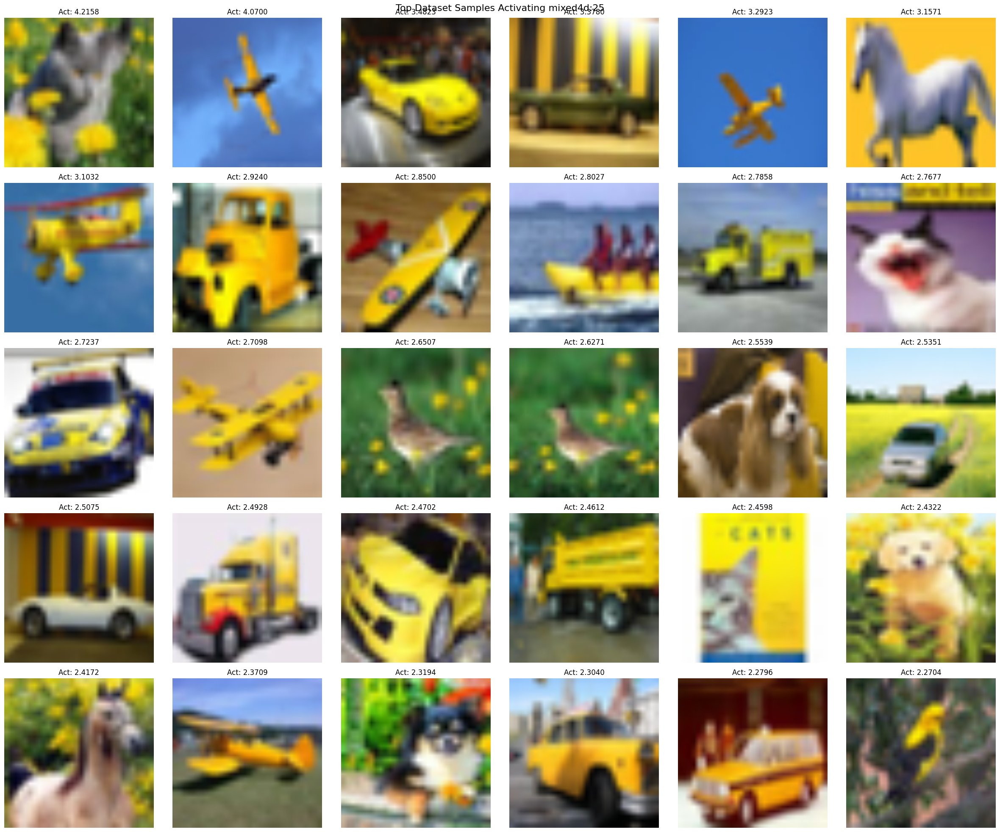

In [ ]:
import torch
import torch.nn as nn
from torchvision import datasets, transforms
from lucent.modelzoo import inceptionv1
import matplotlib.pyplot as plt
import numpy as np

# Device setup
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

# Load model
model = inceptionv1(pretrained=True)
model.to(device).eval()

# Define the layer and channel
layer_name = "mixed4d"
channel_idx = 25

# Hook to capture activations
activations = []

def hook_fn(module, input, output):
    activations.append(output[:, channel_idx].detach().cpu().numpy())

hook = dict([*model.named_modules()])[layer_name].register_forward_hook(hook_fn)

# Load dataset (CIFAR-10 for simplicity; replace with your dataset)
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
])

dataset = datasets.CIFAR10(root='./data', train=False, download=True, transform=transform)

# Adjust batch size to prevent running out of RAM
dataloader = torch.utils.data.DataLoader(dataset, batch_size=16, shuffle=False)

# Compute activations for all dataset samples
activation_scores = []
image_samples = []

with torch.no_grad():
    for images, _ in dataloader:
        images = images.to(device)
        activations.clear()
        model(images)
        activation_batch = activations[0].mean(axis=(1, 2))  # average spatial activations
        activation_scores.extend(activation_batch)
        image_samples.extend(images.cpu())

hook.remove()

# Find top activating images
top_n = 30
top_indices = np.argsort(activation_scores)[-top_n:][::-1]

# Define grid size (multiple rows and columns)
cols = 6
rows = top_n // cols + (top_n % cols > 0)

# Plot the top activating images
fig, axes = plt.subplots(rows, cols, figsize=(cols * 4, rows * 4))
axes = axes.flatten()

for i, idx in enumerate(top_indices):
    img = image_samples[idx].permute(1, 2, 0).numpy()
    img = (img - img.min()) / (img.max() - img.min())
    axes[i].imshow(img)
    axes[i].axis('off')
    axes[i].set_title(f'Act: {activation_scores[idx]:.4f}')

# Turn off any extra axes if number of images is less than total subplots
for ax in axes[len(top_indices):]:
    ax.axis('off')

plt.suptitle(f'Top Dataset Samples Activating {layer_name}:{channel_idx}', fontsize=16)
plt.tight_layout()
plt.show()

"""
vibe coding
the feature visualization for this particular channel is for yellow flowers, planes, cars
"""



---



# TASK 4

Can you figure out and code how to see which dataset samples activate the above channel the most?



---

